In [5]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Image
import matplotlib
%matplotlib inline
matplotlib.rc('image', cmap = 'gray')
import cv2
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

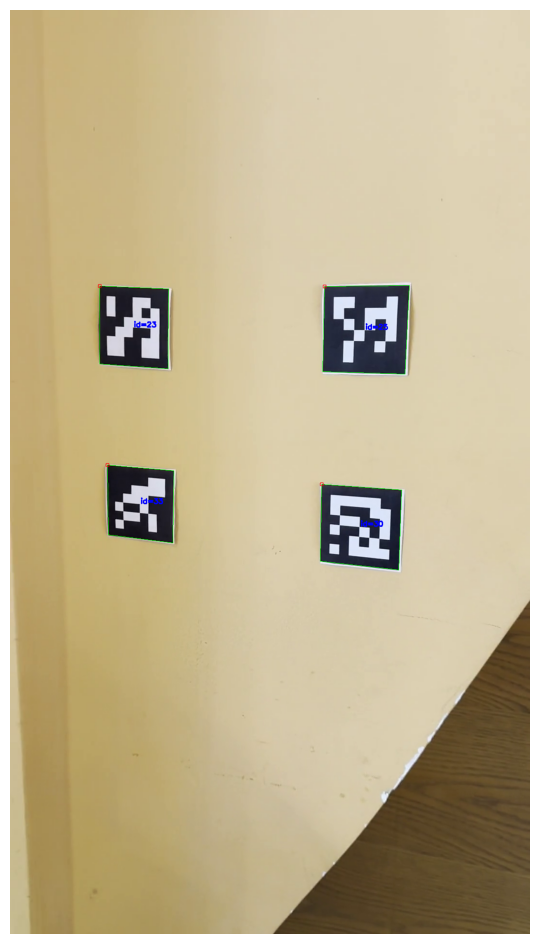

In [3]:
dictionary = cv2.aruco.getPredefinedDictionary(cv2.aruco.DICT_6X6_250)
# Read input image with the markers.
frame_dst = cv2.imread('markertry.png')

# Detect the markers in the destination image.
corners, ids, rejected = cv2.aruco.detectMarkers(frame_dst, dictionary)

frame_detected = frame_dst.copy()

cv2.aruco.drawDetectedMarkers(frame_detected, corners, ids)
plt.figure(figsize = [12,12])
plt.axis('off')
plt.imshow(frame_detected[:,:,::-1])

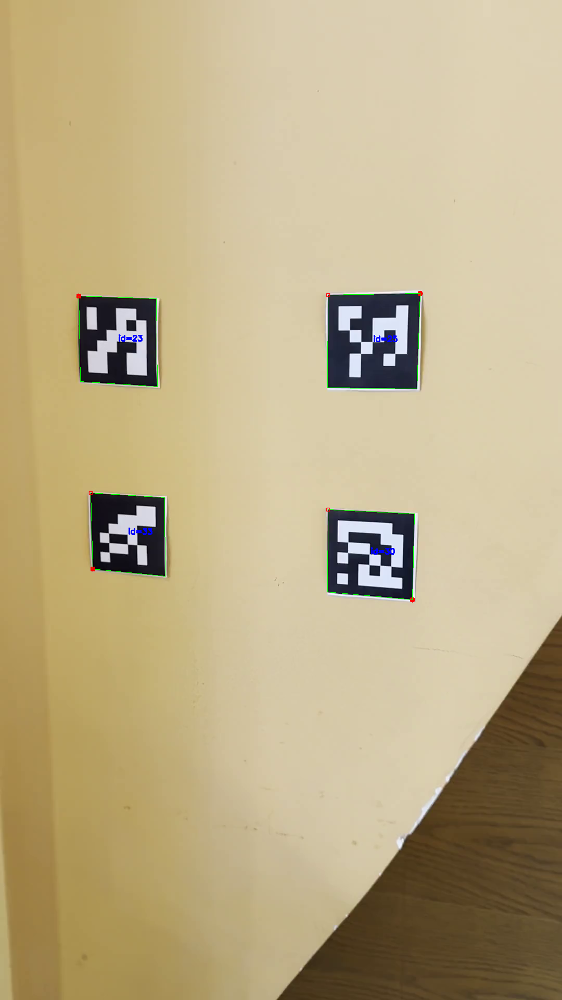

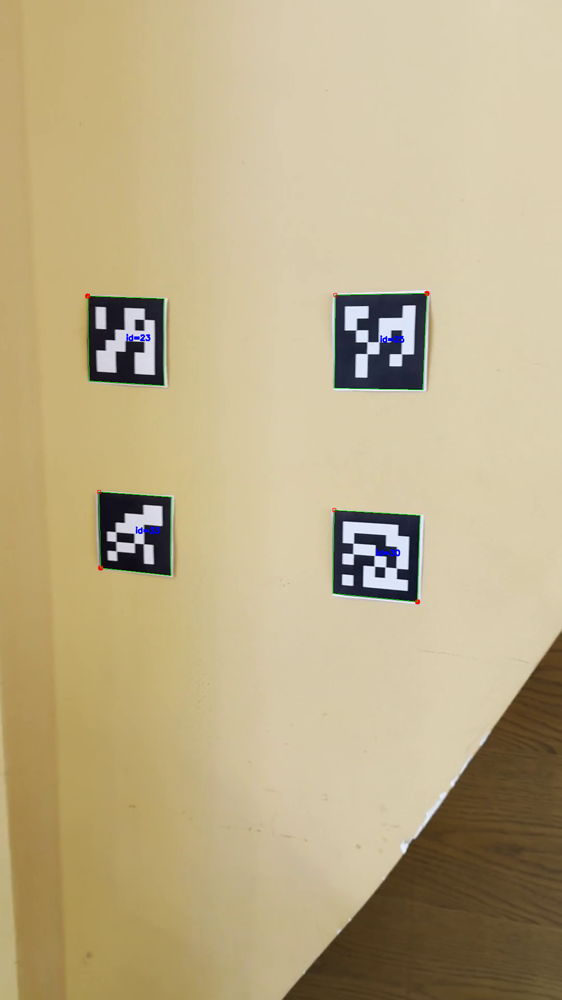

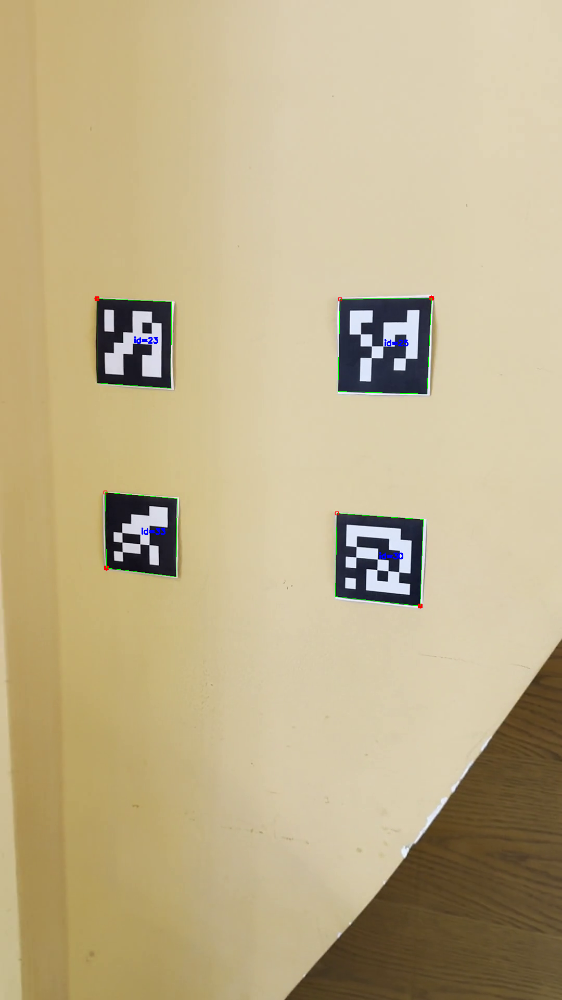

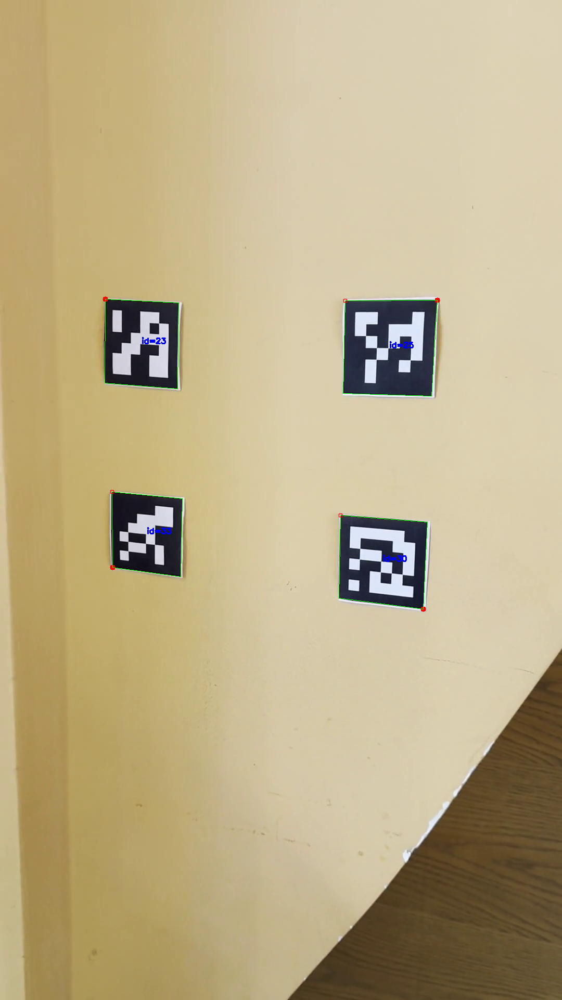

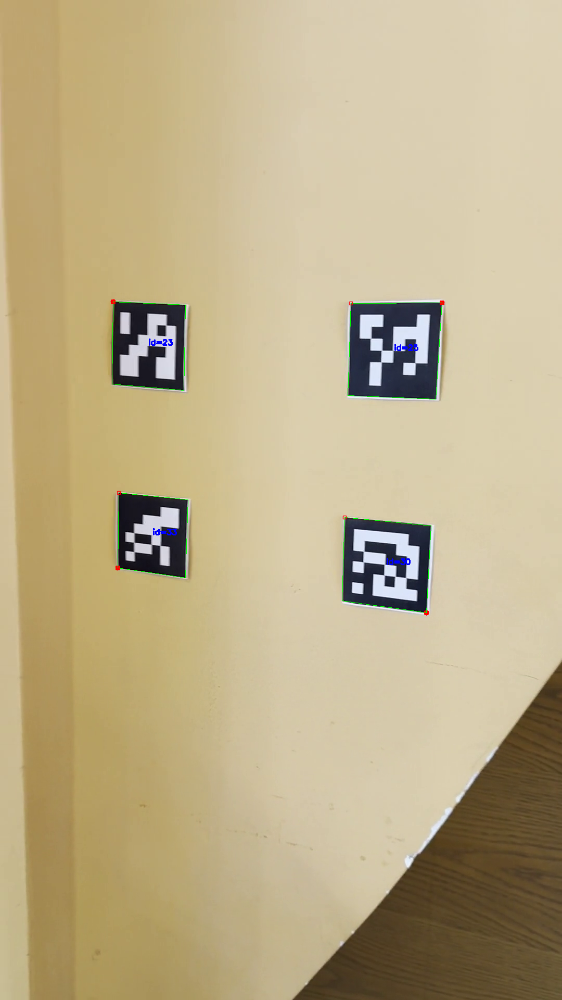

...

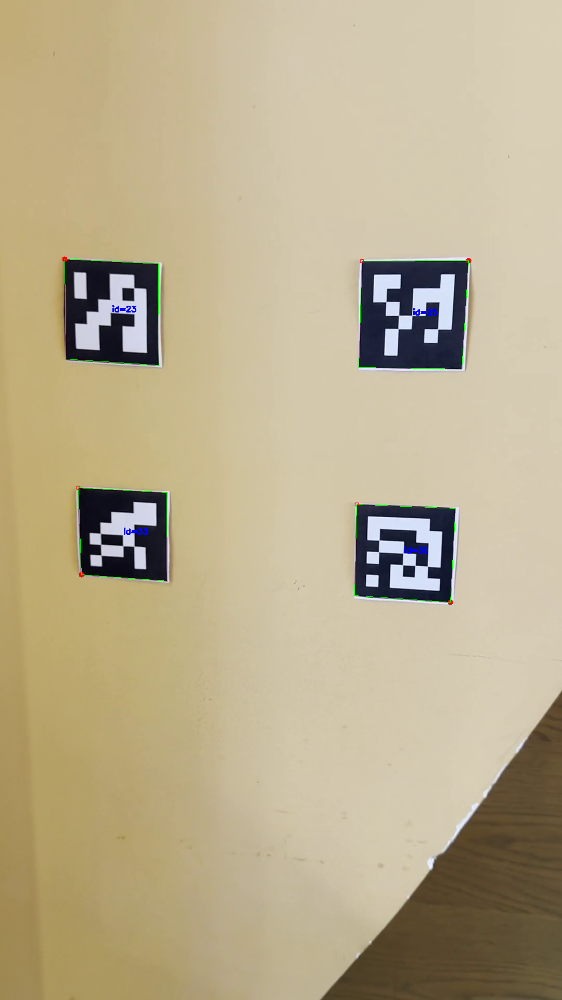

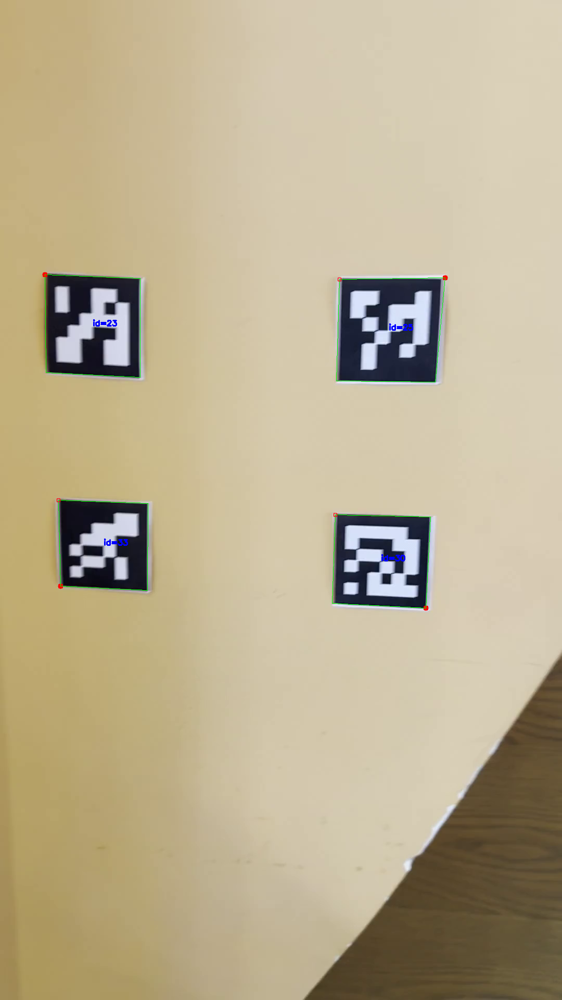

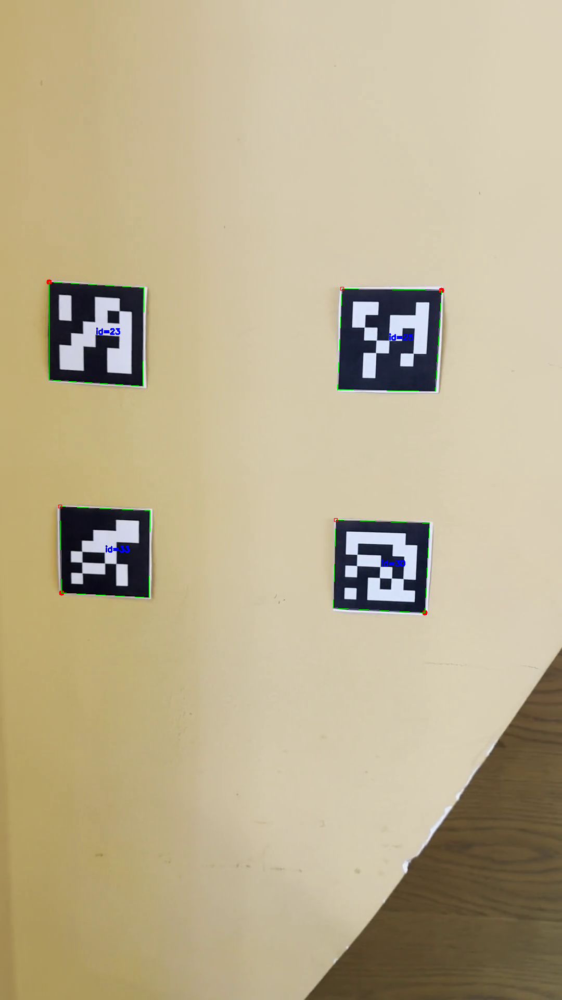

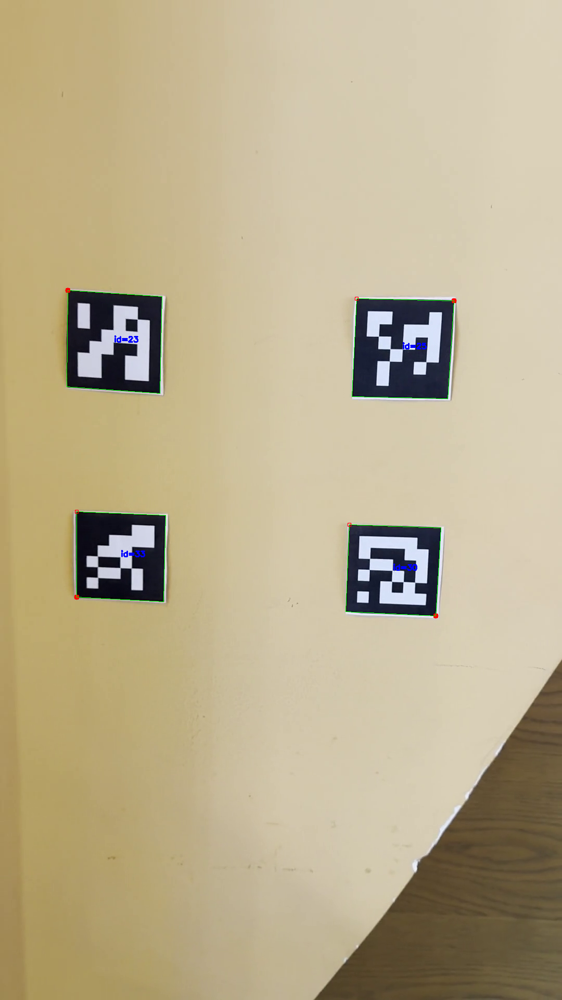

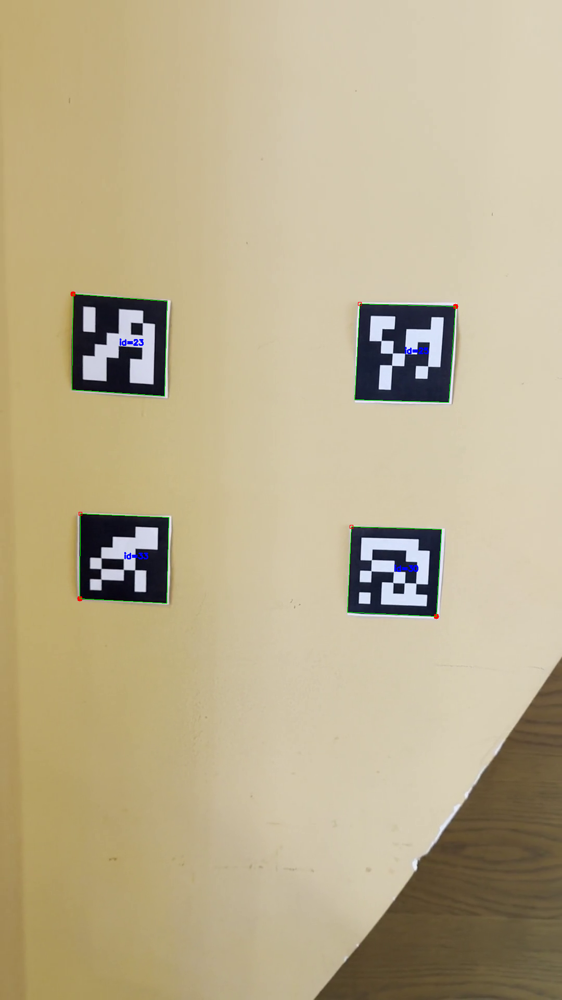

In [6]:
video_path = '/content/try.mp4'
cap = cv2.VideoCapture(video_path)

frame_count = 0

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    corners, ids, _ = cv2.aruco.detectMarkers(frame, dictionary)

    if ids is not None:
        ref_ids = [23, 25, 30, 33]
        ref_pts = {}

        for i, marker_id in enumerate(ref_ids):
            index = np.squeeze(np.where(ids == marker_id))
            if index.size > 0:
                ref_pts[marker_id] = np.squeeze(corners[index[0]])

        if len(ref_pts) == 4:
            ref_pt1 = ref_pts[23][0]  # Upper-left
            ref_pt2 = ref_pts[25][1]  # Upper-right
            ref_pt3 = ref_pts[30][2]  # Lower-right
            ref_pt4 = ref_pts[33][3]  # Lower-left

            for pt in [ref_pt1, ref_pt2, ref_pt3, ref_pt4]:
                cv2.circle(frame, tuple(pt.astype(int)), 5, (0, 0, 255), -1)
        cv2.aruco.drawDetectedMarkers(frame, corners, ids)

    if frame_count % 10 == 0:
        cv2_imshow(frame)

    frame_count += 1
cap.release()

In [19]:
overlay_video_path = '/content/americaya.mp4'

In [20]:
cap = cv2.VideoCapture(video_path)
cap_overlay = cv2.VideoCapture(overlay_video_path)
frame_width = int(cap.get(3))
frame_height = int(cap.get(4))
fps = int(cap.get(cv2.CAP_PROP_FPS))
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter('output.mp4', fourcc, fps, (frame_width, frame_height))

frame_count = 0

In [21]:
aruco_params = cv2.aruco.DetectorParameters()

while cap.isOpened():
    ret_bg, frame_dst = cap.read()
    ret_overlay, frame_overlay = cap_overlay.read()

    if not ret_bg:
        break  # Stop if background video ends

    # Reset overlay video when it finishes
    if not ret_overlay:
        cap_overlay.set(cv2.CAP_PROP_POS_FRAMES, 0)
        ret_overlay, frame_overlay = cap_overlay.read()

    # Convert frame to grayscale
    gray = cv2.cvtColor(frame_dst, cv2.COLOR_BGR2GRAY)
    corners, ids, _ = cv2.aruco.detectMarkers(gray, dictionary, parameters=aruco_params)

    if ids is not None and len(ids) >= 4:
        ids = ids.flatten()

        try:
            ref_pts = {
                23: corners[np.where(ids == 23)[0][0]][0][0],  # Top-left
                25: corners[np.where(ids == 25)[0][0]][0][1],  # Top-right
                30: corners[np.where(ids == 30)[0][0]][0][2],  # Bottom-right
                33: corners[np.where(ids == 33)[0][0]][0][3]   # Bottom-left
            }

            pts_dst_m = np.array([ref_pts[23], ref_pts[25], ref_pts[30], ref_pts[33]])
            overlay_resized = cv2.resize(frame_overlay, (frame_dst.shape[1], frame_dst.shape[0]))
            pts_src_m = np.array([[0, 0],
                                  [overlay_resized.shape[1], 0],
                                  [overlay_resized.shape[1], overlay_resized.shape[0]],
                                  [0, overlay_resized.shape[0]]])

            h, _ = cv2.findHomography(pts_src_m, pts_dst_m, cv2.RANSAC)
            warped_overlay = cv2.warpPerspective(overlay_resized, h, (frame_dst.shape[1], frame_dst.shape[0]))
            mask = np.zeros((frame_dst.shape[0], frame_dst.shape[1]), dtype=np.uint8)
            cv2.fillConvexPoly(mask, np.int32([pts_dst_m]), 255, cv2.LINE_AA)
            mask3 = cv2.merge([mask, mask, mask]) / 255.0
            frame_out = (frame_dst * (1 - mask3) + warped_overlay * mask3).astype(np.uint8)
            out.write(frame_out)
        except Exception as e:
            print(f"Error processing frame {frame_count}: {e}")

    frame_count += 1

cap.release()
cap_overlay.release()
out.release()
print("✅ Output video saved as 'output.mp4'")

✅ Output video saved as 'output.mp4'


In [22]:
from moviepy.editor import VideoFileClip

# Extract overlay audio
overlay_audio_path = "overlay_audio.mp3"
clip = VideoFileClip(overlay_video_path)
clip.audio.write_audiofile(overlay_audio_path)

MoviePy - Writing audio in overlay_audio.mp3


MoviePy - Done.


In [23]:
!ffmpeg -i output.mp4 -i overlay_audio.mp3 -c:v copy -c:a aac -strict experimental output_final.mp4

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab